<h1><center>Schätzung der Gebrauchtwagenpreise</center></h1>

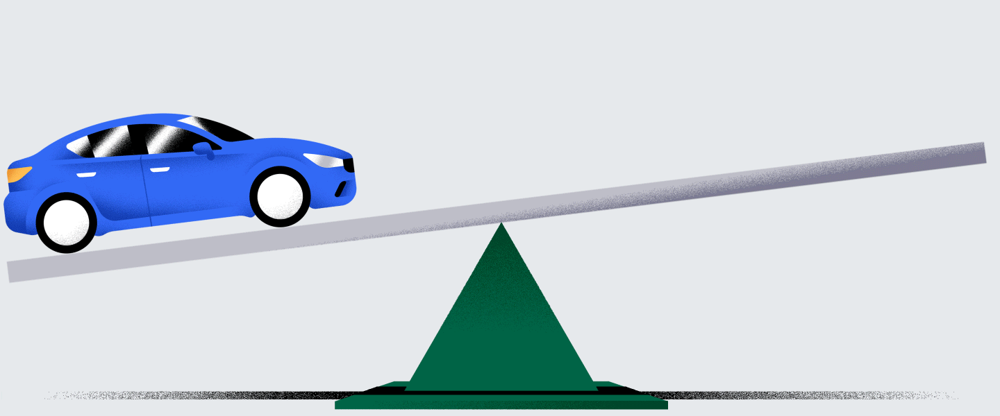

In diesem Projekt werden wir den Preis von Gebrauchtwagen anhand verschiedener Merkmale vorhersagen, wie Marke, Kilometerstand, Kraftstoff, Preis und Erstzulassung.

In [1]:
from bs4 import BeautifulSoup
import requests
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Vorbereitung des Datensatzes

### Web Scraping

Wir werden Daten von einer deutschen Auto-Website scrapen. Wir verwenden Beautiful Soup, die Requests Library und Pandas Dataframe. Die Ergebnisse werden in einer Excel-Datei gespeichert.

In [4]:
website='https://www.12gebrauchtwagen.de/suchen?utf8=%E2%9C%93&s%5Bsort%5D=7'

In [5]:
response = requests.get(website)

In [6]:
response.status_code

200

In [7]:
soup = BeautifulSoup(response.content, 'html.parser')

In [8]:
soup

<!DOCTYPE html>
<html lang="de-DE"><head><meta charset="utf-8"/><meta content="width=device-width, initial-scale=1.0" name="viewport"/><meta content="Vergleiche mit der Autosuche Gebrauchtwagen-Angebote und gebrauchte Autos aus ganz Deutschland." name="description"/><meta content="331234fe526549682f4190782bce61f1" name="verification"/><title>Autosuche: Gebrauchtwagen suchen und vergleichen - 12Gebrauchtwagen.de</title><link href="https://assets1-production.12gebrauchtwagen.de/assets/application-e0dc89f999d557de47878f57a42141c5cdd48896462e5fd0aeab34aabb73b0a3.css" media="all" rel="stylesheet"/><link href="https://assets3-production.12gebrauchtwagen.de/assets/application-fonts-26e7c2ba0592a7a31f63f18a223d3c124da9a0c9758be992dea50abc4af81211.css" media="all" rel="stylesheet"/><link href="https://assets3-production.12gebrauchtwagen.de/assets/apple_touch_icon-a18917842e9dd5542480221abd7e0eb1de7043dc092aa71ea0ac94015b1312f5.png" rel="apple-touch-icon"/><script type="application/ld+json">{"@c

In [9]:
results = soup.find_all('div', class_="row car-ad result-slot box-shadow")

In [10]:
len(results)

22

- #### Erforderliche Daten anpeilen

In [11]:
results[0].find('h3').get_text()

'Mercedes-Benz CLK 230 Coupe Kompressor Sport AUTOMATIK'

In [12]:
results[0].find('span',{'class':'ad-mileage'}).get_text()

'278.000 km'

In [13]:
results[0].find('div',{'class':'small-8 columns float-left'}).get_text()

'Benzin, ca. 9,8 l/100 km (komb.)*, ca. 233 g CO₂/km (komb.)*, B'

In [14]:
results[0].find('span',{'class':'ad-price'}).get_text()

'2.700 €'

In [15]:
results[0].find('span',{'class':'ad-registration-date'}).get_text()

'EZ 11/1997'

In [16]:
Name = []
Kilometerstand = []
Kraftstoff = []
Preis = []
Erstzulassung = []

for result in results :
    #Name
    try :
       Name.append(result.find('h3').get_text())
    except :
       Name.append('nicht verfügbar')
    
    #Kilometerstand
    try :
       Kilometerstand.append(result.find('span',{'class':'ad-mileage'}).get_text())
    except :
       Kilometerstand.append('nicht verfügbar')
    
    #Kraftstoff
    try :
       Kraftstoff.append(result.find('div',{'class':'small-8 columns float-left'}).get_text())
    except :
       Kraftstoff.append('nicht verfügbar')
    
    #Preis
    try :
       Preis.append(result.find('span',{'class':'ad-price'}).get_text())
    except :
       Preis.append('nicht verfügbar')
    
    #Erstzulassung
    try :
       Erstzulassung.append(result.find('span',{'class':'ad-registration-date'}).get_text())
    except :
       Erstzulassung.append('nicht verfügbar')

- #### Erstellen eines Dataframe

In [17]:
Gebrauchtwagen = pd.DataFrame({'Name': Name, 'Kilometerstand':Kilometerstand,'Kraftstoff': Kraftstoff, 'Preis': Preis, 'Erstzulassung':Erstzulassung})

In [18]:
Gebrauchtwagen

,Name,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz CLK 230 Coupe Kompressor Sport A...,278.000 km,"Benzin, ca. 9,8 l/100 km (komb.)*, ca. 233 g C...",2.700 €,EZ 11/1997
1,Ford S-Max - Nur für kurze Zeit: Kostenlose Li...,95.064 km,"Diesel, ca. 5,2 l/100 km (komb.)*, ca. 134 g C...",23.780 €,EZ 08/2018
2,VW Passat Alltrack Volkswagen 2.0 TSI*4Motion*...,11.312 km,"Benzin, ca. 7,1 l/100 km (komb.)*, ca. 163 g C...",34.950 €,EZ 07/2019
3,Peugeot Expert 1.6 L2 Premium Navi R.Cam DAB T...,80.675 km,"Diesel, ca. 137 g CO₂/km (komb.)*",22.500 €,EZ 02/2018
4,BMW 320 Ci Cabrio Klima Navi Xenon M-Paket Har...,165.000 km,"Benzin, ca. 9,8 l/100 km (komb.)*, ca. 236 g C...",12.490 €,EZ 01/2003
5,Mercedes-Benz B 200 BlueEff. Navi Parktronic C...,60.000 km,Benzin,15.950 €,EZ 04/2014
6,Audi RS7 Alu21/HUD/Navi/Leder/ACC/Kamera/Softc...,33.500 km,"Benzin, ca. 9,8 l/100 km (komb.)*, ca. 229 g C...",57.450 €,EZ 04/2014
7,Hyundai i30 Classic *TÜV-NEU*,140.100 km,"Diesel, ca. 4,7 l/100 km (komb.)*, ca. 125 g C...",5.499 €,EZ 11/2010
8,Volvo V90 D5 AWD Inscription,24.500 km,"Diesel, ca. 4,9 l/100 km (komb.)*, ca. 129 g C...",42.500 €,EZ 09/2017
9,Porsche Boxster Basis (Typ 987),77.000 km,"Benzin, ca. 9,6 l/100 km (komb.)*, ca. 228 g C...",28.500 €,EZ 05/2006


- #### Data Cleaning

In [19]:
Gebrauchtwagen['Kilometerstand'] = Gebrauchtwagen['Kilometerstand'].apply(lambda x: x.strip('km'))

In [20]:
def remove(string):
    for i in range(len(string)):
        if string[i] == ',':
            return string[:i]
    return string

In [21]:
for i in range(len(Gebrauchtwagen)):
    m = remove(Gebrauchtwagen['Kraftstoff'][i])
    Gebrauchtwagen['Kraftstoff'][i]=m

In [22]:
Gebrauchtwagen['Preis'] = Gebrauchtwagen['Preis'].apply(lambda x: x.strip('€'))

In [23]:
for i in range(len(Gebrauchtwagen)):
    m = Gebrauchtwagen['Erstzulassung'][i].split('/')[-1]
    Gebrauchtwagen['Erstzulassung'][i]=m

In [24]:
Gebrauchtwagen

,Name,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz CLK 230 Coupe Kompressor Sport A...,278.000,Benzin,2.700,1997
1,Ford S-Max - Nur für kurze Zeit: Kostenlose Li...,95.064,Diesel,23.780,2018
2,VW Passat Alltrack Volkswagen 2.0 TSI*4Motion*...,11.312,Benzin,34.950,2019
3,Peugeot Expert 1.6 L2 Premium Navi R.Cam DAB T...,80.675,Diesel,22.500,2018
4,BMW 320 Ci Cabrio Klima Navi Xenon M-Paket Har...,165.000,Benzin,12.490,2003
5,Mercedes-Benz B 200 BlueEff. Navi Parktronic C...,60.000,Benzin,15.950,2014
6,Audi RS7 Alu21/HUD/Navi/Leder/ACC/Kamera/Softc...,33.500,Benzin,57.450,2014
7,Hyundai i30 Classic *TÜV-NEU*,140.100,Diesel,5.499,2010
8,Volvo V90 D5 AWD Inscription,24.500,Diesel,42.500,2017
9,Porsche Boxster Basis (Typ 987),77.000,Benzin,28.500,2006


- #### Paginierung

In [26]:
Name = []
Kilometerstand = []
Kraftstoff = []
Preis = []
Erstzulassung = []

for i in range(1,120):
    
    website = "https://www.12gebrauchtwagen.de/suchen?page="+str(i)+"&s%5Bsort%5D=7"
    response = requests.get(website)
    soup = BeautifulSoup(response.content, 'html.parser')
    results = soup.find_all('div', class_="row car-ad result-slot box-shadow")
    for result in results :
    #Name
     try :
       Name.append(result.find('h3').get_text())
     except :
       Name.append('nicht verfügbar')
    
    #Kilometerstand
     try :
       Kilometerstand.append(result.find('span',{'class':'ad-mileage'}).get_text())
     except :
       Kilometerstand.append('nicht verfügbar')
    
    #Kraftstoff
     try :
       Kraftstoff.append(result.find('div',{'class':'small-8 columns float-left'}).get_text())
     except :
       Kraftstoff.append('nicht verfügbar')
    
    #Preis
     try :
       Preis.append(result.find('span',{'class':'ad-price'}).get_text())
     except :
       Preis.append('nicht verfügbar')
    
    #Erstzulassung
     try :
       Erstzulassung.append(result.find('span',{'class':'ad-registration-date'}).get_text())
     except :
       Erstzulassung.append('nicht verfügbar')
    
    

In [27]:
Gebrauchtwagen = pd.DataFrame({'Name': Name, 'Kilometerstand':Kilometerstand,'Kraftstoff': Kraftstoff, 'Preis': Preis, 'Erstzulassung':Erstzulassung})

In [28]:
Gebrauchtwagen

,Name,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz CLK 230 Coupe Kompressor Sport A...,278.000 km,"Benzin, ca. 9,8 l/100 km (komb.)*, ca. 233 g C...",2.700 €,EZ 11/1997
1,Ford S-Max - Nur für kurze Zeit: Kostenlose Li...,95.064 km,"Diesel, ca. 5,2 l/100 km (komb.)*, ca. 134 g C...",23.780 €,EZ 08/2018
2,VW Passat Alltrack Volkswagen 2.0 TSI*4Motion*...,11.312 km,"Benzin, ca. 7,1 l/100 km (komb.)*, ca. 163 g C...",34.950 €,EZ 07/2019
3,Peugeot Expert 1.6 L2 Premium Navi R.Cam DAB T...,80.675 km,"Diesel, ca. 137 g CO₂/km (komb.)*",22.500 €,EZ 02/2018
4,BMW 320 Ci Cabrio Klima Navi Xenon M-Paket Har...,165.000 km,"Benzin, ca. 9,8 l/100 km (komb.)*, ca. 236 g C...",12.490 €,EZ 01/2003
...,...,...,...,...,...
2377,Opel Astra H Twin Top Cosmo,150.000 km,"Diesel, ca. 6,1 l/100 km (komb.)*, ca. 165 g C...",5.650 €,EZ 03/2007
2378,Abarth 595 Pista 70h,54.042 km,"Benzin, ca. 6,9 l/100 km (komb.)*, ca. 158 g C...",19.888 €,EZ 02/2020
2379,Mercedes-Benz SL 320 Xenon Voll Nappaleder AMG...,41.370 km,"Benzin, ca. 11,5 l/100 km (komb.)*, ca. 275 g ...",45.900 €,EZ 04/1999
2380,VW Polo Volkswagen V 6R Life PDC Klimaaut. 5 t...,106.000 km,"Benzin, ca. 5,4 l/100 km (komb.)*, ca. 128 g C...",8.490 €,EZ 12/2013


In [32]:
Gebrauchtwagen['Kilometerstand'] = Gebrauchtwagen['Kilometerstand'].apply(lambda x: x.strip('km'))

def remove(string):
    for i in range(len(string)):
        if string[i] == ',':
            return string[:i]
    return string
for i in range(len(Gebrauchtwagen)):
    m = remove(Gebrauchtwagen['Kraftstoff'][i])
    Gebrauchtwagen['Kraftstoff'][i]=m
    
def remove2(string):
    for i in range(len(string)):
        if string[i] == '€':
            return string[:i]
    return string

for i in range(len(Gebrauchtwagen)):
    m = remove2(Gebrauchtwagen['Preis'][i])
    Gebrauchtwagen['Preis'][i]=m
    
for i in range(len(Gebrauchtwagen)):
    m = Gebrauchtwagen['Erstzulassung'][i].split('/')[-1]
    Gebrauchtwagen['Erstzulassung'][i]=m

In [33]:
Gebrauchtwagen

,Name,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz CLK 230 Coupe Kompressor Sport A...,278.000,Benzin,2.700,1997
1,Ford S-Max - Nur für kurze Zeit: Kostenlose Li...,95.064,Diesel,23.780,2018
2,VW Passat Alltrack Volkswagen 2.0 TSI*4Motion*...,11.312,Benzin,34.950,2019
3,Peugeot Expert 1.6 L2 Premium Navi R.Cam DAB T...,80.675,Diesel,22.500,2018
4,BMW 320 Ci Cabrio Klima Navi Xenon M-Paket Har...,165.000,Benzin,12.490,2003
...,...,...,...,...,...
2377,Opel Astra H Twin Top Cosmo,150.000,Diesel,5.650,2007
2378,Abarth 595 Pista 70h,54.042,Benzin,19.888,2020
2379,Mercedes-Benz SL 320 Xenon Voll Nappaleder AMG...,41.370,Benzin,45.900,1999
2380,VW Polo Volkswagen V 6R Life PDC Klimaaut. 5 t...,106.000,Benzin,8.490,2013


In [34]:
Gebrauchtwagen.to_csv('gw.csv', index=False)

In [35]:
gw = pd.read_csv("gw.csv")
gw

,Name,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz CLK 230 Coupe Kompressor Sport A...,278.000,Benzin,2.700,1997
1,Ford S-Max - Nur für kurze Zeit: Kostenlose Li...,95.064,Diesel,23.780,2018
2,VW Passat Alltrack Volkswagen 2.0 TSI*4Motion*...,11.312,Benzin,34.950,2019
3,Peugeot Expert 1.6 L2 Premium Navi R.Cam DAB T...,80.675,Diesel,22.500,2018
4,BMW 320 Ci Cabrio Klima Navi Xenon M-Paket Har...,165.000,Benzin,12.490,2003
...,...,...,...,...,...
2377,Opel Astra H Twin Top Cosmo,150.000,Diesel,5.650,2007
2378,Abarth 595 Pista 70h,54.042,Benzin,19.888,2020
2379,Mercedes-Benz SL 320 Xenon Voll Nappaleder AMG...,41.370,Benzin,45.900,1999
2380,VW Polo Volkswagen V 6R Life PDC Klimaaut. 5 t...,106.000,Benzin,8.490,2013


In [42]:
gw['Erstzulassung']

0       1997
1       2018
2       2019
3       2018
4       2003
        ... 
2377    2007
2378    2020
2379    1999
2380    2013
2381    2009
Name: Erstzulassung, Length: 2382, dtype: object

In [44]:
gw = gw[gw.Erstzulassung != '-'].copy()
gw['Erstzulassung'] = gw['Erstzulassung'].astype(str).astype(float)

In [45]:
gw

,Name,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz CLK 230 Coupe Kompressor Sport A...,278.000,Benzin,2.700,1997.0
1,Ford S-Max - Nur für kurze Zeit: Kostenlose Li...,95.064,Diesel,23.780,2018.0
2,VW Passat Alltrack Volkswagen 2.0 TSI*4Motion*...,11.312,Benzin,34.950,2019.0
3,Peugeot Expert 1.6 L2 Premium Navi R.Cam DAB T...,80.675,Diesel,22.500,2018.0
4,BMW 320 Ci Cabrio Klima Navi Xenon M-Paket Har...,165.000,Benzin,12.490,2003.0
...,...,...,...,...,...
2377,Opel Astra H Twin Top Cosmo,150.000,Diesel,5.650,2007.0
2378,Abarth 595 Pista 70h,54.042,Benzin,19.888,2020.0
2379,Mercedes-Benz SL 320 Xenon Voll Nappaleder AMG...,41.370,Benzin,45.900,1999.0
2380,VW Polo Volkswagen V 6R Life PDC Klimaaut. 5 t...,106.000,Benzin,8.490,2013.0


In [46]:
gw['Preis']

0        2.700 
1       23.780 
2       34.950 
3       22.500 
4       12.490 
         ...   
2377     5.650 
2378    19.888 
2379    45.900 
2380     8.490 
2381     4.980 
Name: Preis, Length: 2358, dtype: object

In [50]:
gw['Preis'] = gw['Preis'].str.replace('.', '').astype(float)

In [51]:
gw

,Name,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz CLK 230 Coupe Kompressor Sport A...,278.000,Benzin,2700.0,1997.0
1,Ford S-Max - Nur für kurze Zeit: Kostenlose Li...,95.064,Diesel,23780.0,2018.0
2,VW Passat Alltrack Volkswagen 2.0 TSI*4Motion*...,11.312,Benzin,34950.0,2019.0
3,Peugeot Expert 1.6 L2 Premium Navi R.Cam DAB T...,80.675,Diesel,22500.0,2018.0
4,BMW 320 Ci Cabrio Klima Navi Xenon M-Paket Har...,165.000,Benzin,12490.0,2003.0
...,...,...,...,...,...
2377,Opel Astra H Twin Top Cosmo,150.000,Diesel,5650.0,2007.0
2378,Abarth 595 Pista 70h,54.042,Benzin,19888.0,2020.0
2379,Mercedes-Benz SL 320 Xenon Voll Nappaleder AMG...,41.370,Benzin,45900.0,1999.0
2380,VW Polo Volkswagen V 6R Life PDC Klimaaut. 5 t...,106.000,Benzin,8490.0,2013.0


In [54]:
gw['Kilometerstand'] = pd.to_numeric(gw['Kilometerstand'], errors='coerce')

In [56]:
gw

,Name,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz CLK 230 Coupe Kompressor Sport A...,278.000,Benzin,2700.0,1997.0
1,Ford S-Max - Nur für kurze Zeit: Kostenlose Li...,95.064,Diesel,23780.0,2018.0
2,VW Passat Alltrack Volkswagen 2.0 TSI*4Motion*...,11.312,Benzin,34950.0,2019.0
3,Peugeot Expert 1.6 L2 Premium Navi R.Cam DAB T...,80.675,Diesel,22500.0,2018.0
4,BMW 320 Ci Cabrio Klima Navi Xenon M-Paket Har...,165.000,Benzin,12490.0,2003.0
...,...,...,...,...,...
2377,Opel Astra H Twin Top Cosmo,150.000,Diesel,5650.0,2007.0
2378,Abarth 595 Pista 70h,54.042,Benzin,19888.0,2020.0
2379,Mercedes-Benz SL 320 Xenon Voll Nappaleder AMG...,41.370,Benzin,45900.0,1999.0
2380,VW Polo Volkswagen V 6R Life PDC Klimaaut. 5 t...,106.000,Benzin,8490.0,2013.0


In [55]:
print(gw['Kraftstoff'].unique())

['Benzin' 'Diesel' 'Hybrid' 'Elektro' 'Andere' 'Autogas (LPG)'
 'Erdgas (CNG)']


In [57]:
gw['Name'].isnull().sum()

0

In [59]:
r=gw['Name'].unique()
r

array(['Mercedes-Benz CLK 230 Coupe Kompressor Sport AUTOMATIK',
       'Ford S-Max - Nur für kurze Zeit: Kostenlose Lieferung inkl. Zulassung',
       'VW Passat Alltrack Volkswagen 2.0 TSI*4Motion*Cam*ACC*Navi*LED',
       ...,
       'Mercedes-Benz SL 320 Xenon Voll Nappaleder AMG Sehr gepflegt',
       'VW Polo Volkswagen V 6R Life PDC Klimaaut. 5 türig 1.HAND',
       'VW Golf Volkswagen V Variant/ Comfortline /1,4TSI/S-Heft/'],
      dtype=object)

In [60]:
len(r)

2111

In der Spalte Name stehen 836 eindeutige Namen. Das ist wirklich schwer zu implementieren und eine Regression würde mehr als 300 Dummies bedeuten.Lassen Sie uns an der Marke arbeiten, nicht am Namen des Autos

In [61]:
gw.dtypes

Name               object
Kilometerstand    float64
Kraftstoff         object
Preis             float64
Erstzulassung     float64
dtype: object

In [62]:
gw['Name'] = gw['Name'].apply(str)
gw['Name'] = gw['Name'].astype(str)

In [63]:
def erstesWort(string):
    return string.split()[0]
gw['Name'] = gw['Name'].apply(lambda x: erstesWort(x))

In [64]:
gw['Name'].unique()

array(['Mercedes-Benz', 'Ford', 'VW', 'Peugeot', 'BMW', 'Audi', 'Hyundai',
       'Volvo', 'Porsche', 'Opel', 'Jaguar', 'Renault', 'Jeep', 'Seat',
       'Citroën', 'Fiat', 'Alfa', 'Saab', 'Mazda', 'Cadillac', 'Dacia',
       'Rolls-Royce', 'Lotus', 'Mini', 'Skoda', 'Smart', 'Nissan',
       'Daewoo', 'Maserati', 'Land', 'Corvette', 'Mitsubishi', 'Infiniti',
       'Ferrari', 'Toyota', 'Lexus', 'Alpina', 'Chevrolet', 'Suzuki',
       'Maybach', 'Bentley', 'Kia', 'Lada', 'Lamborghini', 'Fisker',
       'Chrysler', 'Hummer', 'Abarth', 'Honda', 'MG', 'Dodge', 'Aston',
       'Pontiac', 'Cupra', 'Lincoln', 'KTM', 'Others', 'Oldtimer',
       'Lancia', 'Subaru', 'Daihatsu', 'Austin', 'Ligier',
       'StreetScooter', 'SsangYong', 'Trabant', 'NSU', 'Moskvich', '9ff',
       'Caravans-Wohnm', 'AC', 'Morgan', 'IVECO', 'VAZ', 'GMC',
       'Wartburg', 'GAZ'], dtype=object)

In [65]:
def replace(string):
    first_word = string.split()[0]
    if first_word.lower() == 'aston':
        first_word = 'Aston Martin'
    elif first_word.lower() == 'morgan':
        first_word = 'Morgan Motor Company'
    elif first_word.lower() == 'alfa':
        first_word = 'Alfa Romeo'
    elif first_word.lower() == 'vw':
        first_word = 'Volkswagen'
    elif first_word.lower() == 'mini':
        first_word = 'BMW'
    return first_word
gw['Name'] = gw['Name'].apply(lambda x: replace(x))

In [68]:
gw['Name'].unique()

array(['Mercedes-Benz', 'Ford', 'Volkswagen', 'Peugeot', 'BMW', 'Audi',
       'Hyundai', 'Volvo', 'Porsche', 'Opel', 'Jaguar', 'Renault', 'Jeep',
       'Seat', 'Citroën', 'Fiat', 'Alfa Romeo', 'Saab', 'Mazda',
       'Cadillac', 'Dacia', 'Rolls-Royce', 'Lotus', 'Skoda', 'Smart',
       'Nissan', 'Daewoo', 'Maserati', 'Land', 'Corvette', 'Mitsubishi',
       'Infiniti', 'Ferrari', 'Toyota', 'Lexus', 'Alpina', 'Chevrolet',
       'Suzuki', 'Maybach', 'Bentley', 'Kia', 'Lada', 'Lamborghini',
       'Fisker', 'Chrysler', 'Hummer', 'Abarth', 'Honda', 'MG', 'Dodge',
       'Aston Martin', 'Pontiac', 'Cupra', 'Lincoln', 'KTM', 'Others',
       'Oldtimer', 'Lancia', 'Subaru', 'Daihatsu', 'Austin', 'Ligier',
       'StreetScooter', 'SsangYong', 'Trabant', 'NSU', 'Moskvich', '9ff',
       'Caravans-Wohnm', 'AC', 'Morgan Motor Company', 'IVECO', 'VAZ',
       'GMC', 'Wartburg', 'GAZ'], dtype=object)

In [69]:
gw = gw.rename(columns={'Name': 'Marke'})

In [70]:
gw.to_csv('gw1.csv', index=False)

In [71]:
gw1 = pd.read_csv("gw1.csv")

In [76]:
gw1

,Marke,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz,278.000,Benzin,2700.0,1997.0
1,Ford,95.064,Diesel,23780.0,2018.0
2,Volkswagen,11.312,Benzin,34950.0,2019.0
3,Peugeot,80.675,Diesel,22500.0,2018.0
4,BMW,165.000,Benzin,12490.0,2003.0
...,...,...,...,...,...
2353,Opel,150.000,Diesel,5650.0,2007.0
2354,Abarth,54.042,Benzin,19888.0,2020.0
2355,Mercedes-Benz,41.370,Benzin,45900.0,1999.0
2356,Volkswagen,106.000,Benzin,8490.0,2013.0


##### - Um unseren Datensatz zu vergrößern und unser Modell genauer zu machen, kombinieren wir unseren "web-scraped" Datensatz mit einem anderen.

In [81]:
gw2 = pd.read_csv("car_price_data1.csv")
gw2

,Brand,Price,Body,Mileage,EngineV,Engine Type,Registration,Year,Model
0,BMW,4200.0,sedan,277,2.0,Petrol,yes,1991,320
1,Mercedes-Benz,7900.0,van,427,2.9,Diesel,yes,1999,Sprinter 212
2,Mercedes-Benz,13300.0,sedan,358,5.0,Gas,yes,2003,S 500
3,Audi,23000.0,crossover,240,4.2,Petrol,yes,2007,Q7
4,Toyota,18300.0,crossover,120,2.0,Petrol,yes,2011,Rav 4
...,...,...,...,...,...,...,...,...,...
4340,Mercedes-Benz,125000.0,sedan,9,3.0,Diesel,yes,2014,S 350
4341,BMW,6500.0,sedan,1,3.5,Petrol,yes,1999,535
4342,BMW,8000.0,sedan,194,2.0,Petrol,yes,1985,520
4343,Toyota,14200.0,sedan,31,NaN,Petrol,yes,2014,Corolla


In [82]:
gw2 = gw2.drop(["Body", "EngineV","Model","Registration"], axis=1)

In [87]:
gw2 = gw2.rename(columns={'Brand': 'Marke'})
gw2 = gw2.rename(columns={'Price': 'Preis'})
gw2 = gw2.rename(columns={'Mileage': 'Kilometerstand'})
gw2 = gw2.rename(columns={'Engine Type': 'Kraftstoff'})
gw2 = gw2.rename(columns={'Year': 'Erstzulassung'})

In [97]:
gw2

,Marke,Preis,Kilometerstand,Kraftstoff,Erstzulassung
0,BMW,4200.0,277,Petrol,1991
1,Mercedes-Benz,7900.0,427,Diesel,1999
2,Mercedes-Benz,13300.0,358,Gas,2003
3,Audi,23000.0,240,Petrol,2007
4,Toyota,18300.0,120,Petrol,2011
...,...,...,...,...,...
4340,Mercedes-Benz,125000.0,9,Diesel,2014
4341,BMW,6500.0,1,Petrol,1999
4342,BMW,8000.0,194,Petrol,1985
4343,Toyota,14200.0,31,Petrol,2014


In [98]:
df = pd.concat([gw1, gw2])

In [99]:
df

,Marke,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz,278.000,Benzin,2700.0,1997.0
1,Ford,95.064,Diesel,23780.0,2018.0
2,Volkswagen,11.312,Benzin,34950.0,2019.0
3,Peugeot,80.675,Diesel,22500.0,2018.0
4,BMW,165.000,Benzin,12490.0,2003.0
...,...,...,...,...,...
4340,Mercedes-Benz,9.000,Diesel,125000.0,2014.0
4341,BMW,1.000,Petrol,6500.0,1999.0
4342,BMW,194.000,Petrol,8000.0,1985.0
4343,Toyota,31.000,Petrol,14200.0,2014.0


In [101]:
df['Kraftstoff'].unique()

array(['Benzin', 'Diesel', 'Hybrid', 'Elektro', 'Andere', 'Autogas (LPG)',
       'Erdgas (CNG)', 'Petrol', 'Gas', 'Other'], dtype=object)

In [102]:
df['Kraftstoff'].replace({'Other': 'Andere','Autogas (LPG)': 'Gas','Erdgas (CNG)': 'Gas'}, inplace = True)

In [104]:
df['Kraftstoff'].unique()

array(['Benzin', 'Diesel', 'Hybrid', 'Elektro', 'Andere', 'Gas', 'Petrol'],
      dtype=object)

In [111]:
df.to_csv('df.csv', index=False)

In [4]:
df = pd.read_csv('df.csv')

In [5]:
df

,Marke,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz,278.000,Benzin,2700.0,1997.0
1,Ford,95.064,Diesel,23780.0,2018.0
2,Volkswagen,11.312,Benzin,34950.0,2019.0
3,Peugeot,80.675,Diesel,22500.0,2018.0
4,BMW,165.000,Benzin,12490.0,2003.0
...,...,...,...,...,...
6698,Mercedes-Benz,9.000,Diesel,125000.0,2014.0
6699,BMW,1.000,Petrol,6500.0,1999.0
6700,BMW,194.000,Petrol,8000.0,1985.0
6701,Toyota,31.000,Petrol,14200.0,2014.0


In [5]:
df.dtypes

Marke              object
Kilometerstand    float64
Kraftstoff         object
Preis             float64
Erstzulassung     float64
dtype: object

In [7]:
df.to_excel (r'C:\Users\zaido\OneDrive\Bureau\PFA\df.xlsx', index = None, header=True)

- unser Datensatz ist endlich fertig !

# "Preprocessing" und "Data Exploration"

##### Für eine schnelle und genauere explorative Datenanalyse werden wir eine leistungsstarke Bibliothek verwenden, die Einblicke in den Datensatz bietet

In [3]:
!pip install -U dataprep

In [7]:
from dataprep.eda import create_report

  0%|          | 0/794 [00:00<?, ?it/s]

mein Bericht
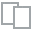
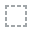
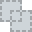
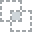
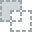
...
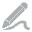
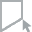
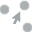
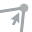
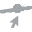

In [8]:
report = create_report(df, title='mein Bericht')
report

### - Der Datensatz hat 309 (4,6%) doppelte Zeilen
- Identifizierung doppelter Zeilen

In [9]:
duplicate_rows = df[df.duplicated()]

- Berechnung des Prozentsatzes der zu entfernenden doppelten Zeilen

In [10]:
num_duplicate_rows = len(duplicate_rows)
percent= 4.6
num_to_remove = int(num_duplicate_rows * percent / 100)

- Entfernung der doppelten Zeilen

In [11]:
df1 = df.drop(duplicate_rows.sample(num_to_remove).index)

- Lassen wir alle fehlenden Werte weg, was nicht immer empfehlenswert ist. Wenn wir jedoch weniger als 5 % der Daten entfernen, ist dies in Ordnung.

In [12]:
df_no_mv= df1.dropna()

In [13]:
df_no_mv.isna().sum()

Marke             0
Kilometerstand    0
Kraftstoff        0
Preis             0
Erstzulassung     0
dtype: int64

In [ ]:
data = df['Erstzulassung']

# Create a figure and axis
fig, ax = plt.subplots()

# Create the box plot
ax.boxplot(data, vert=False)

# Set labels and title
ax.set_xlabel('Erstzulassung')
ax.set_title('Box Plot of Erstzulassung')

# Display the plot
plt.show()

- Die **Wahrscheinlichkeitsverteilung** zeigt uns, wie diese Variable verteilt ist. Dadurch lassen sich Anomalien wie **Ausreißer** sehr leicht erkennen.

Text(0.5, 1.0, 'Autopreis-Verteilungsdiagramm')

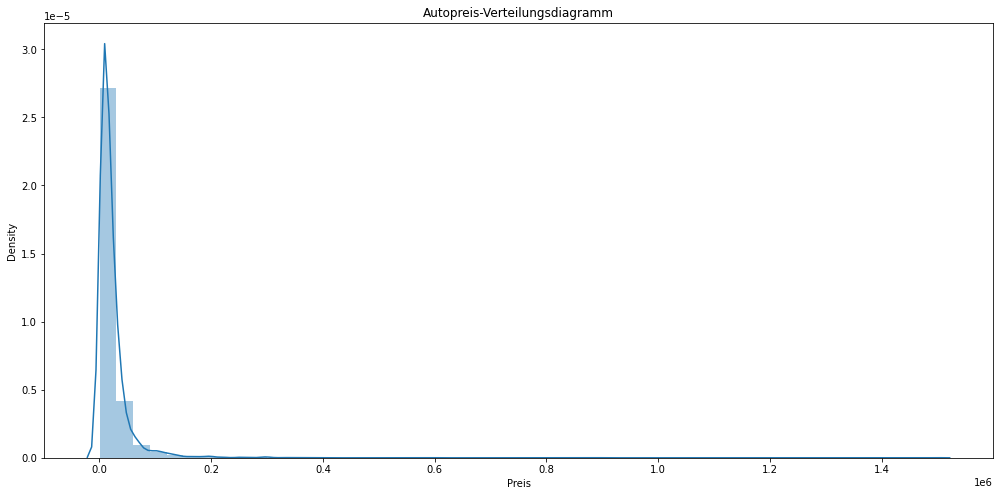

In [14]:
plt.figure(figsize=[17,8])
sns.distplot(df_no_mv['Preis'])
plt.title('Autopreis-Verteilungsdiagramm')

Text(0.5, 1.0, 'Autokilometer-Verteilungsdiagramm')

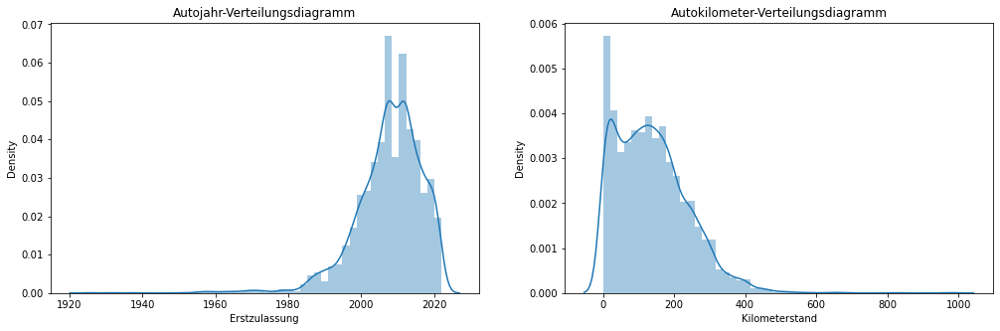

In [15]:
plt.figure(figsize=[17,5])
plt.subplot(1,2,1)
sns.distplot(df_no_mv['Erstzulassung'])
plt.title('Autojahr-Verteilungsdiagramm')

plt.subplot(1,2,2)
sns.distplot(df_no_mv['Kilometerstand'])
plt.title('Autokilometer-Verteilungsdiagramm')

- es ist klar, dass einige Ausreißer bei den numerischen Variablen Preis, Jahr und Kilometerstand auftreten

#### Umgang mit Ausreißern

##### - Preis-Spalte

Hier befinden sich die Ausreißer um die höheren Preise herum (rechte Seite des Diagramms). Wir können das Problem leicht lösen, indem wir 0,5 % oder 1 % der problematischen Stichproben entfernen. Da es sich um einen Datensatz über Gebrauchtwagen handelt, kann man sich vorstellen, dass 10000000 ein überhöhter Preis ist.

In [16]:
q = df_no_mv['Preis'].quantile(0.99)
data_1 = df_no_mv[df_no_mv['Preis']<q]

Text(0.5, 1.0, 'Autopreis-Verteilungsdiagramm')

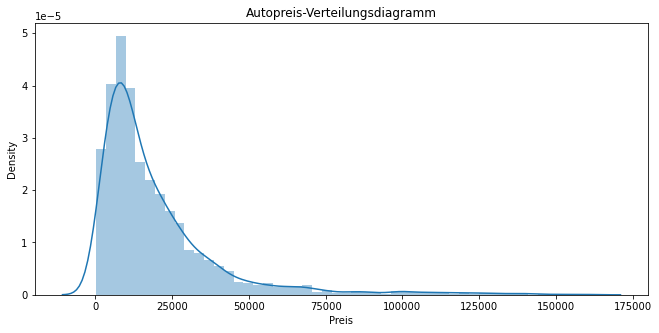

In [17]:
plt.figure(figsize=[11,5])
sns.distplot(data_1['Preis'])
plt.title('Autopreis-Verteilungsdiagramm')

##### - Kilometerstand-Spalte

In [18]:
q = data_1['Kilometerstand'].quantile(0.99)
data_2 = data_1[data_1['Kilometerstand']<q]

<AxesSubplot:xlabel='Kilometerstand', ylabel='Density'>

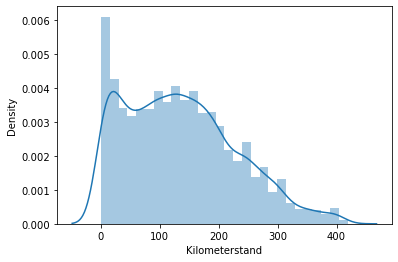

In [19]:
sns.distplot(data_2['Kilometerstand'])

##### - Erstzulassung-Spalte

- hier sind die Ausreißer am unteren Ende

In [20]:
q = data_2['Erstzulassung'].quantile(0.01)
data_3 = data_2[data_2['Erstzulassung']>q]

<AxesSubplot:xlabel='Erstzulassung', ylabel='Density'>

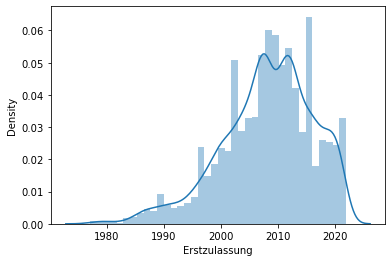

In [21]:
sns.distplot(data_3['Erstzulassung'])

In [22]:
cleaned_data = data_3.reset_index(drop=True)

In [23]:
cleaned_data.describe()

,Kilometerstand,Preis,Erstzulassung
count,6319.000000,6319.000000,6319.000000
mean,136.322187,19847.169166,2008.168381
std,94.121995,20896.673599,8.057101
min,0.000000,299.000000,1977.000000
25%,59.000000,7300.000000,2003.000000
50%,128.000000,13000.000000,2009.000000
75%,199.000000,24800.000000,2014.000000
max,419.000000,159999.000000,2022.000000


### lets check the linearity using a scatter plot

<AxesSubplot:title={'center':'Preis und Kilometerstand'}, xlabel='Preis', ylabel='Kilometerstand'>

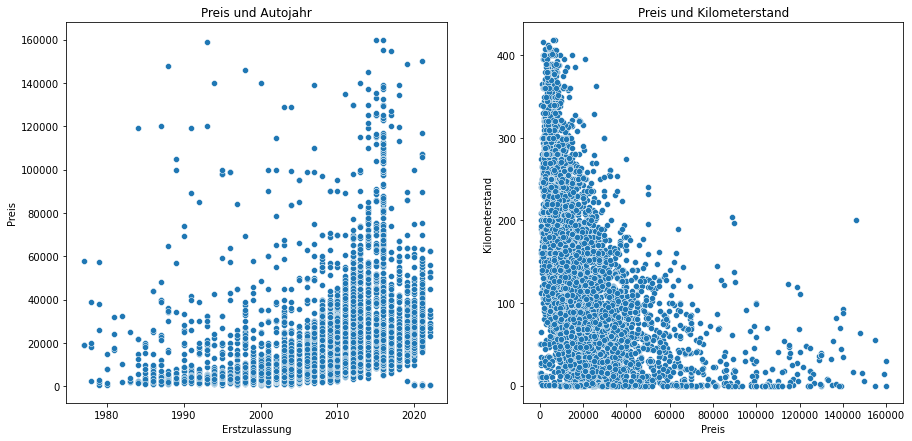

In [24]:
plt.figure(figsize=[15,7])
plt.subplot(1,2,1)
plt.title("Preis und Autojahr")
sns.scatterplot(x='Erstzulassung',y='Preis',data=cleaned_data)

plt.subplot(1,2,2)
plt.title("Preis und Kilometerstand")
sns.scatterplot(x='Preis',y='Kilometerstand',data=cleaned_data)

Wir wissen, dass wir in diesem Fall keine lineare Regression durchführen sollten. Wir sollten zunächst eine oder mehrere Variablen transformieren. Das Verteilungsdiagramm des Preises zu all diesen Diagrammen zeigt, dass der Preis nicht normalverteilt ist.

<AxesSubplot:xlabel='Preis', ylabel='Density'>

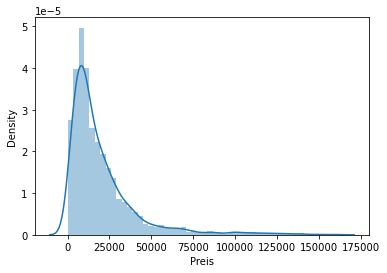

In [25]:
sns.distplot(cleaned_data['Preis'])

In [28]:
cleaned_data.to_csv('cleaned_dataa.csv', index=False)

In [26]:
cleaned_data.to_excel (r'C:\Users\zaido\OneDrive\Bureau\PFA\cleaned_data.xlsx', index = None, header=True)

Die Muster sind ziemlich exponentiell. In diesem Fall ist die Log-Transformation eine gängige Methode, um mit diesem Problem umzugehen. Die Log-Transformation ist besonders nützlich, wenn man mit "exponentiellen Streudiagrammen" (**exponential scatter plots)** konfrontiert wird, wie wir es jetzt tun.

In [5]:
cleaned_data = pd.read_csv('cleaned_data.csv')
cleaned_data

,Marke,Kilometerstand,Kraftstoff,Preis,Erstzulassung
0,Mercedes-Benz,278.000,Benzin,2700.0,1997.0
1,Ford,95.064,Diesel,23780.0,2018.0
2,Volkswagen,11.312,Benzin,34950.0,2019.0
3,Peugeot,80.675,Diesel,22500.0,2018.0
4,BMW,165.000,Benzin,12490.0,2003.0
...,...,...,...,...,...
6314,Mercedes-Benz,9.000,Diesel,125000.0,2014.0
6315,BMW,1.000,Petrol,6500.0,1999.0
6316,BMW,194.000,Petrol,8000.0,1985.0
6317,Toyota,31.000,Petrol,14200.0,2014.0


## Überprüfung der Beziehung zwischen Unternehmen und Preis

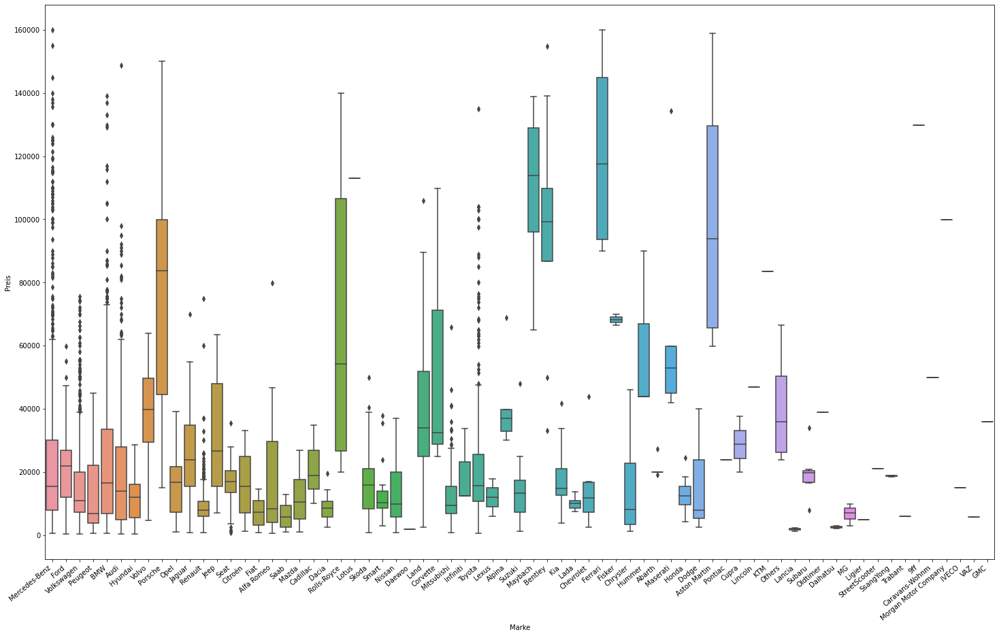

In [10]:
plt.subplots(figsize=(25,15))
ax=sns.boxplot(x='Marke',y='Preis',data=cleaned_data)
ax.set_xticklabels(ax.get_xticklabels(),rotation=40,ha='right')
plt.show()

## Checking relationship of Year with Price

C:\Users\zaido\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\zaido\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\zaido\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 41.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\zaido\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 37.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\zaido\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 50.0% of the points

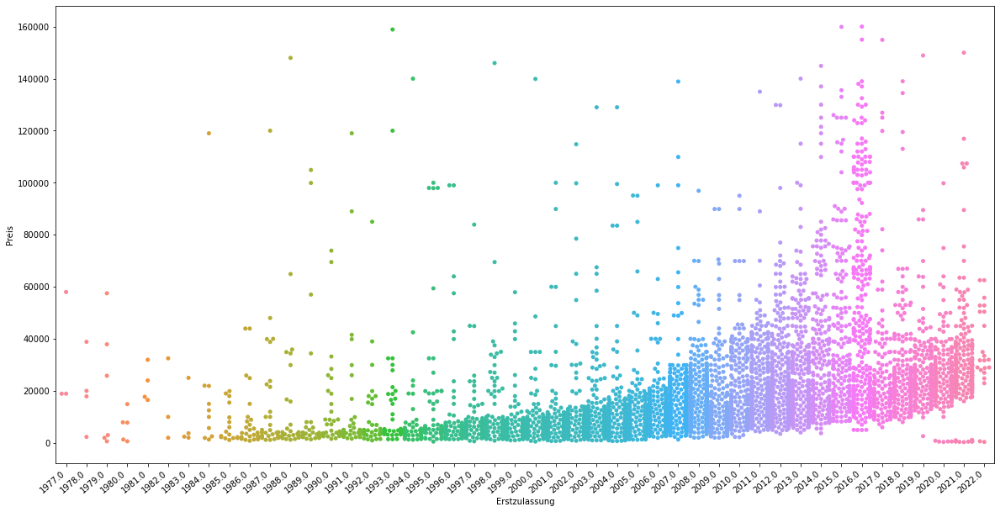

In [13]:
plt.subplots(figsize=(20,10))
ax=sns.swarmplot(x='Erstzulassung',y='Preis',data=cleaned_data)
ax.set_xticklabels(ax.get_xticklabels(),rotation=40,ha='right')
plt.show()

## Checking relationship of kilometerstand with Price¶

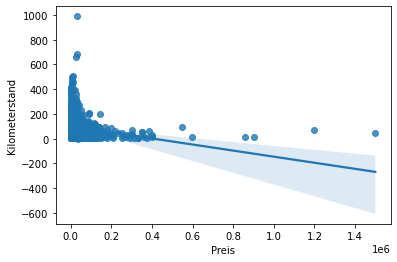

In [195]:
sns.regplot(x=gw['Preis'], y=gw['Kilometerstand'])
plt.show()

je weniger...

## Checking relationship of Fuel Type with Price

<AxesSubplot:xlabel='Kraftstoff', ylabel='Preis'>

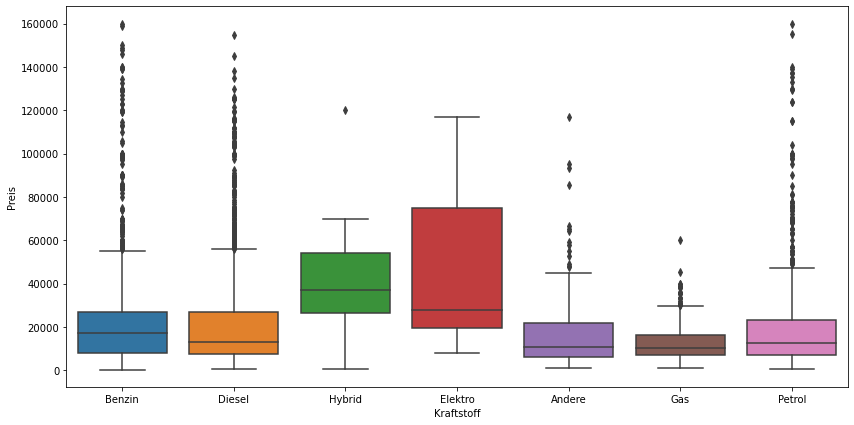

In [14]:
plt.subplots(figsize=(14,7))
sns.boxplot(x='Kraftstoff',y='Preis',data=cleaned_data)

## Relationship of Price with FuelType, Year and Company mixed

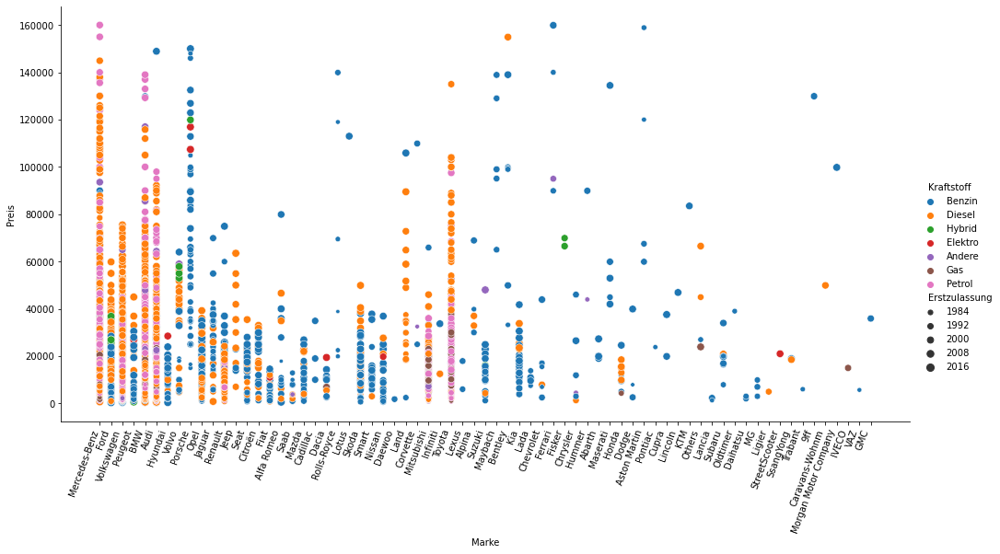

In [17]:
ax=sns.relplot(x='Marke',y='Preis',data=cleaned_data,hue='Kraftstoff',size='Erstzulassung',height=7,aspect=2)
ax.set_xticklabels(rotation=70,ha='right')

In [29]:
log_Preis= np.log(cleaned_data['Preis'])
cleaned_data['log_Preis'] = log_Preis
cleaned_data.head()

,Marke,Kilometerstand,Kraftstoff,Preis,Erstzulassung,log_Preis
0,Mercedes-Benz,278.000,Benzin,2700.0,1997.0,7.901007
1,Ford,95.064,Diesel,23780.0,2018.0,10.076600
2,Volkswagen,11.312,Benzin,34950.0,2019.0,10.461674
3,Peugeot,80.675,Diesel,22500.0,2018.0,10.021271
4,BMW,165.000,Benzin,12490.0,2003.0,9.432684


Schauen wir uns die Streuungen noch einmal an

<AxesSubplot:title={'center':'Log Preis und Kilometerstand'}, xlabel='log_Preis', ylabel='Kilometerstand'>

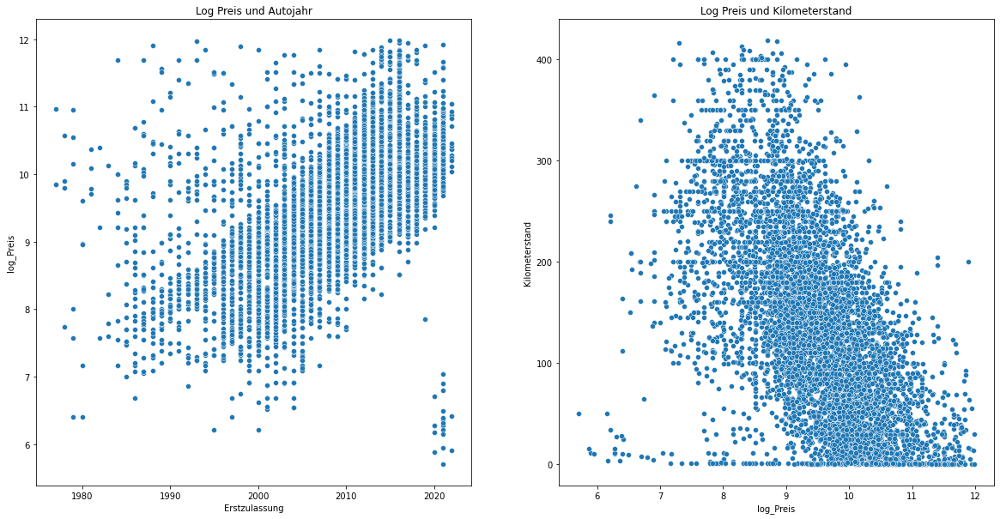

In [30]:
plt.figure(figsize=[20,10])
plt.subplot(1,2,1)
plt.title("Log Preis und Autojahr")
sns.scatterplot(x='Erstzulassung',y='log_Preis',data=cleaned_data)

plt.subplot(1,2,2)
plt.title("Log Preis und Kilometerstand")
sns.scatterplot(x='log_Preis',y='Kilometerstand',data=cleaned_data)

- Da wir die logarithmische Preisvariable verwenden werden, können wir die alte Variable "Preis" weglassen

In [31]:
cleaned_data = cleaned_data.drop(['Preis'],axis=1)

In [32]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
variables = cleaned_data[['Kilometerstand','Erstzulassung']]
vif = pd.DataFrame()
vif["VIF"] = [variance_inflation_factor(variables.values, i) for i in range(variables.shape[1])]

vif["Features"] = variables.columns
vif

,VIF,Features
0,3.075335,Kilometerstand
1,3.075335,Erstzulassung


In [33]:
from sklearn.preprocessing import LabelEncoder
temp_data = cleaned_data.copy()
for col in temp_data.columns:
    if temp_data[col].dtypes == 'object':
        encoder = LabelEncoder()
        temp_data[col] = encoder.fit_transform(temp_data[col])
        
# Correated Features with target variable
print('\n--Correated Features with target variable--\n')
print(abs(temp_data.corrwith(temp_data['log_Preis'])).sort_values(ascending=False)[1:])


--Correated Features with target variable--

Kilometerstand    0.569462
Erstzulassung     0.547453
Marke             0.056444
Kraftstoff        0.042033
dtype: float64


<AxesSubplot:>

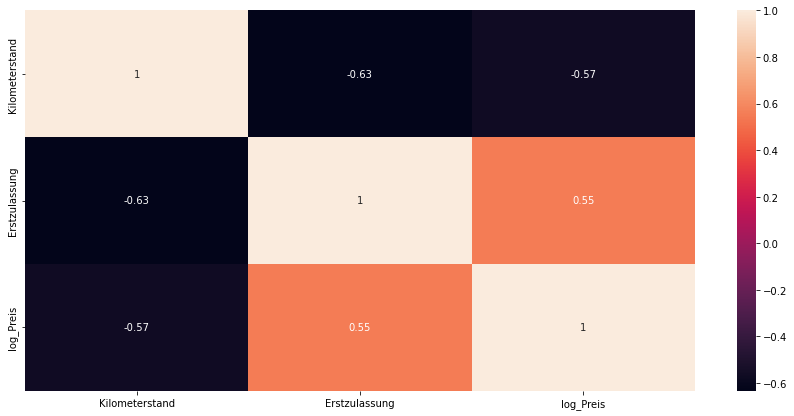

In [34]:
# correlation heat map
plt.figure(figsize=[15,7])
sns.heatmap(cleaned_data.corr(), annot=True)

In [35]:
# Important feature using ExtraTreesRegressor
from sklearn.ensemble import ExtraTreesRegressor
X = temp_data.drop('log_Preis',axis=1)
y = temp_data['log_Preis']
model = ExtraTreesRegressor()
model.fit(X,y)

ExtraTreesRegressor()

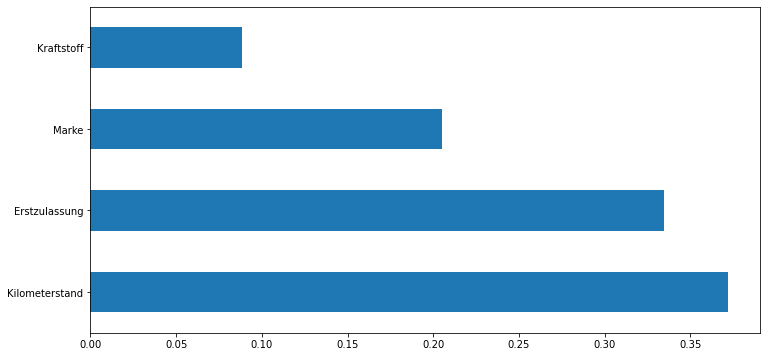

In [36]:
# plot graph of feature importances for better visualization
plt.figure(figsize=[12,6])
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(6).plot(kind='barh')
plt.show()

In [37]:
print(feat_importances.sort_values(ascending=False))

Kilometerstand    0.371897
Erstzulassung     0.334498
Marke             0.205226
Kraftstoff        0.088379
dtype: float64


In [38]:
#Creating Dummie Variables
data_with_dummies = pd.get_dummies(cleaned_data,drop_first=True)

In [39]:
data_with_dummies.head()

,Kilometerstand,Erstzulassung,log_Preis,Marke_Abarth,Marke_Alfa Romeo,Marke_Alpina,Marke_Aston Martin,Marke_Audi,Marke_BMW,Marke_Bentley,...,Marke_Trabant,Marke_VAZ,Marke_Volkswagen,Marke_Volvo,Kraftstoff_Benzin,Kraftstoff_Diesel,Kraftstoff_Elektro,Kraftstoff_Gas,Kraftstoff_Hybrid,Kraftstoff_Petrol
0,278.000,1997.0,7.901007,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,95.064,2018.0,10.076600,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2,11.312,2019.0,10.461674,0,0,0,0,0,0,0,...,0,0,1,0,1,0,0,0,0,0
3,80.675,2018.0,10.021271,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
4,165.000,2003.0,9.432684,0,0,0,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0


In [40]:
x = data_with_dummies.drop('log_Preis',axis=1)
y = data_with_dummies['log_Preis']

In [32]:
data_with_dummies.to_csv('data_with_dummies.csv', index=False)

In [33]:
data_with_dummies = pd.read_csv("data_with_dummies.csv")

In [41]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(x[['Kilometerstand','Erstzulassung']])

StandardScaler()

In [42]:
inputs_scaled = scaler.transform(x[['Kilometerstand','Erstzulassung']])
scaled_data = pd.DataFrame(inputs_scaled,columns=['Kilometerstand','Erstzulassung'])

In [43]:
input_scaled2 =scaled_data.join(x.drop(['Kilometerstand','Erstzulassung'],axis=1))

In [44]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(input_scaled2,y,test_size=0.2, random_state=365)

In [45]:
# Model Building
from sklearn.linear_model import LinearRegression
lr = LinearRegression()

# Training Model
lr.fit(x_train,y_train)

# Model Summary
y_pred_lr = lr.predict(x_test)

r_squared = r2_score(y_test,y_pred_lr)
rmse = np.sqrt(mean_squared_error(y_test,y_pred_lr))
print("R_squared :",r_squared)
print("RMSE :",rmse)

R_squared : 0.5945180188068379
RMSE : 0.6191185022608608


In [47]:
# Model Building
from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor()

# Training Model
rf.fit(x_train,y_train)

# Model Summary
y_pred_rf = rf.predict(x_test)

r_squared = r2_score(y_test,y_pred_rf)
rmse = np.sqrt(mean_squared_error(y_test,y_pred_rf))
print("R_squared :",r_squared)
print("RMSE :",rmse)

R_squared : 0.6664186652559813
RMSE : 0.5615505722709605


In [48]:
# Model Building
from sklearn.ensemble import GradientBoostingRegressor
gbt = GradientBoostingRegressor()

# Training Model
gbt.fit(x_train,y_train)

# Model Summary
y_pred_gbt = gbt.predict(x_test)

r_squared = r2_score(y_test,y_pred_gbt)
rmse = np.sqrt(mean_squared_error(y_test,y_pred_gbt))
print("R_squared :",r_squared)
print("RMSE :",rmse)

R_squared : 0.6586694899970147
RMSE : 0.5680356042270435


In [50]:
df_ev = pd.DataFrame(np.exp(y_pred_rf), columns=['Predicted Price'])

y_test = y_test.reset_index(drop=True)
df_ev['Actual Price'] = np.exp(y_test)

df_ev['Residual'] = df_ev['Actual Price'] - df_ev['Predicted Price']
df_ev['Difference%'] = np.absolute(df_ev['Residual']/df_ev['Actual Price']*100)

pd.set_option('display.float_format', lambda x: '%.2f' % x)
df_ev.sort_values(by=['Difference%'])

df_ev.tail(30)

,Predicted Price,Actual Price,Residual,Difference%
1234,2897.82,4400.00,1502.18,34.14
1235,11937.41,9200.00,-2737.41,29.75
1236,3283.37,8900.00,5616.63,63.11
1237,10025.21,7100.00,-2925.21,41.20
1238,3889.81,4000.00,110.19,2.75
1239,11302.53,9800.00,-1502.53,15.33
1240,29934.94,32000.00,2065.06,6.45
1241,13275.70,12700.00,-575.70,4.53
1242,6569.21,6800.00,230.79,3.39
1243,36439.36,26600.00,-9839.36,36.99


In [43]:
import pickle

# Save the trained model to disk
with open('rf_model.pkl', 'wb') as file:
    pickle.dump(rf, file)